# MOXSI Thresholding Experiments

Test out different thresholding schemes using test data taken with the CIS 115 using an Fe-55 source.

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import axisartist
from mpl_toolkits.axes_grid1 import host_subplot
from astropy.io import fits
from astropy import units as u
import pathlib
from astropy.visualization import quantity_support,AsymmetricPercentileInterval
from astropy.modeling import models, fitting
import xarray

%matplotlib inline

In [3]:
energy_fe_55 = [5.88765,5.89875,6.49045] * u.keV

In [4]:
energy_per_electron = 3.65 * u.Unit('eV / electron')
camera_gain = 1.6 * u.DN / u.electron

In [5]:
dn_fe_55 = (energy_fe_55 / energy_per_electron * camera_gain).to('DN')

In [6]:
dn_fe_55

<Quantity [2580.88767123, 2585.75342466, 2845.12876712] DN>

In [7]:
def load_cis_dataset(pre_dark_path, post_dark_path, data_path):
    return {
        'pre_dark': load_dir_to_xarray(pre_dark_path),
        'post_dark': load_dir_to_xarray(post_dark_path),
        'data': load_dir_to_xarray(data_path),
    }


def load_dir_to_xarray(directory):
    data = []
    for filename in sorted(directory.glob('*.fits')):
        hdul = fits.open(filename)
        data.append(hdul[0].data)
        header = hdul[0].header
    return xarray.DataArray(
        np.array(data),
        dims=['sample', 'x', 'y'],
        attrs=dict(header),
    )

In [8]:
cwd = pathlib.Path.cwd()

Three different data sets analyzed, one from 2024-08-16 and two from 2024-08-20, at three different tempertures.

In [9]:
ds_13c = load_cis_dataset(
    cwd / pathlib.Path('2024-08-20') / 'Fe55_13C_Kapton_Off_320ns_Sample' / 'Dark1',
    cwd / pathlib.Path('2024-08-20') / 'Fe55_13C_Kapton_Off_320ns_Sample' / 'Dark2',
    cwd / pathlib.Path('2024-08-20') / 'Fe55_13C_Kapton_Off_320ns_Sample' / 'Xray',
)
ds_4c = load_cis_dataset(
    cwd / pathlib.Path('2024-08-20') / 'Fe55_4C_Kapton_Off_320ns_Sample' / 'Dark1',
    cwd / pathlib.Path('2024-08-20') / 'Fe55_4C_Kapton_Off_320ns_Sample' / 'Dark2',
    cwd / pathlib.Path('2024-08-20') / 'Fe55_4C_Kapton_Off_320ns_Sample' / 'Xray',
)
ds_m10c = load_cis_dataset(
    cwd / pathlib.Path('CubIXSS_FM01_Fe55_2024-08-16') / 'Dark1_-10C',
    cwd / pathlib.Path('CubIXSS_FM01_Fe55_2024-08-16') / 'Dark2_-10C',
    cwd / pathlib.Path('CubIXSS_FM01_Fe55_2024-08-16') / 'Xray_-10C',
)

    Header size is not multiple of 2880: 2688
There may be extra bytes after the last HDU or the file is corrupted. [astropy.io.fits.hdu.hdulist]


In [10]:
def make_image_plots(ds,
                     data_index=0,
                     threshold_func=None,
                     func_kwargs={},
                     hist_range=None,
                     mean_guess=None,
                     stddev_guess=None):
    interval = AsymmetricPercentileInterval(0.5,99.9)
    fig = plt.figure(figsize=(15,10),layout="constrained")
    fig.suptitle(f'Subtraction function: {threshold_func.__name__}')
    axes = fig.subplot_mosaic(
        """
        ABC
        DEF
        """,
        subplot_kw={'aspect':'auto'}
    )
    # Pre-dark
    vmin,vmax = interval.get_limits(ds['pre_dark'].mean(dim='sample'))
    ds['pre_dark'].mean(dim='sample').plot.imshow(
        vmin=vmin,
        vmax=vmax,
        interpolation=None,
        ax=axes['A'],
    )
    axes['A'].set_title(f'Pre dark, {ds["pre_dark"].attrs["HTDETP"]} C')
    # Post-dark
    vmin,vmax = interval.get_limits(ds['post_dark'].mean(dim='sample'))
    ds['post_dark'].mean(dim='sample').plot.imshow(
        vmin=vmin,
        vmax=vmax,
        interpolation=None,
        ax=axes['B'],
    )
    axes['B'].set_title(f'Post dark, {ds["post_dark"].attrs["HTDETP"]} C')
    # Data
    data_slice = ds['data'].isel(sample=data_index)
    vmin,vmax = interval.get_limits(data_slice)
    data_slice.plot.imshow(
        vmin=vmin,
        vmax=vmax,
        interpolation=None,
        ax=axes['C'],
    )
    axes['C'].set_title(f'Exposed image, {ds["data"].attrs["HTDETP"]} C')
    # Thresholded
    if threshold_func is not None:
        # Plot thresholded image
        data_thresh = threshold_func(ds['pre_dark'], ds['post_dark'], ds['data'], **func_kwargs)
        vmin,vmax = interval.get_limits(data_thresh.isel(sample=data_index))
        vmax = np.fabs([vmin,vmax]).max()
        rdbu_cmap = plt.get_cmap('RdBu')
        #rdbu_cmap.set_over('black')
        data_thresh.isel(sample=data_index).plot.imshow(
            vmin=-vmax,
            vmax=vmax,
            cmap=rdbu_cmap,
            interpolation=None,
            ax=axes['D'],
        )
        axes['D'].set_title(f'Dark-subtracted image')
        # Get histogram of thresholded image
        hist_data,bin_edges,_ = data_thresh.plot.hist(
            bins=100,#'doane',
            range=(-100,100) if hist_range is None else hist_range,
            histtype='step',
            ax=axes['E'],
            color='C2'
        )
        ax2 = axes['E'].twiny()
        hist_raw,bin_edges_raw,_ = ds['data'].plot.hist(
            bins=100,
            range=(ds['data'].mean().data-300,ds['data'].mean().data+300),
            histtype='stepfilled',
            alpha=0.2,
            color='k',
            ax=ax2,
            #density=True,
        )
        fitter = fitting.LevMarLSQFitter()
        g2 = (models.Gaussian1D(mean=ds['data'].mean().data,stddev=100,amplitude=hist_raw.max())
              +models.Gaussian1D(mean=ds['data'].mean().data,stddev=100,amplitude=hist_raw.max()))
        bin_centers_raw = (bin_edges_raw[1:]+bin_edges_raw[:-1])/2
        g2_fit = fitter(g2, bin_centers_raw, hist_raw)
        ax2.plot(bin_centers_raw, g2_fit(bin_centers_raw), color='k', label='data')
        for _g in g2_fit:
            ax2.plot(bin_centers_raw, _g(bin_centers_raw), ls='--',
                     label=f'$\mu={_g.mean.value:.2f},\sigma={_g.stddev.value:.2f}$')
        ax2.legend(loc=2)
        # Fit histogram of thresholded image
        gaussian = models.Gaussian1D(
            mean=0 if mean_guess is None else mean_guess,
            stddev=10 if stddev_guess is None else stddev_guess,
            amplitude=hist_data.max()
        ) 
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        try:
            g_fit = fitter(gaussian, bin_centers, hist_data)
        except TypeError:
            pass
        else:
            axes['E'].plot(bin_centers, g_fit(bin_centers),color='C3')
            #axes['E'].set_xlim(-100,100)
            axes['E'].set_title(f'$\mu={g_fit.mean.value:.2f},\sigma={g_fit.stddev.value:.2f}$')
        # Zoom into histogram of hits
        hist_data,bin_edges,_ = data_thresh.plot.hist(
            bins='doane',
            range=dn_fe_55.value[[0,-1]]+np.array([-900,-100]),
            histtype='step',
            ax=axes['F'],
        )
        return data_thresh

## Case 1: Take average over all pre- and post-dark images

In [12]:
def mean_full_array(pre, post, data):
    avg_dark = (pre.mean(dim='sample') + post.mean(dim='sample'))/2
    return data - avg_dark

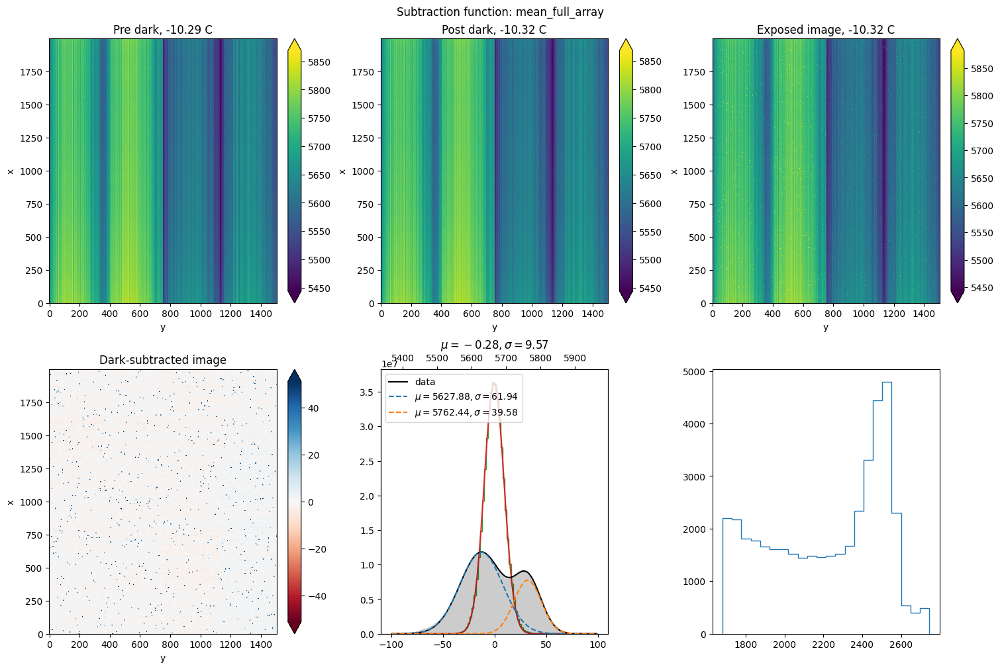

In [199]:
data_thresh_best = make_image_plots(ds_m10c, threshold_func=mean_full_array, )

## Case 2: Scalar Median from all darks

In [200]:
def scalar_median(pre, post, data):
    return data - (pre.median() + post.median()).median()

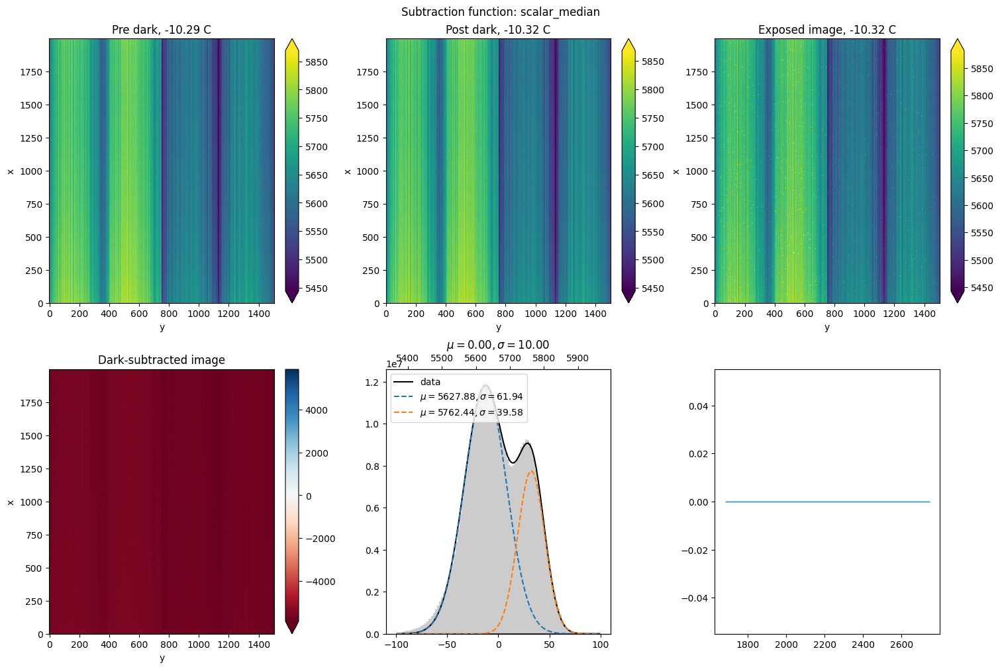

In [201]:
data_thresh = make_image_plots(ds_m10c, threshold_func=scalar_median)

## Case 3: Median along columns

In [202]:
def column_median(pre, post, data):
    return data - xarray.concat([pre, post], 'sample').median(dim=['sample','x'])

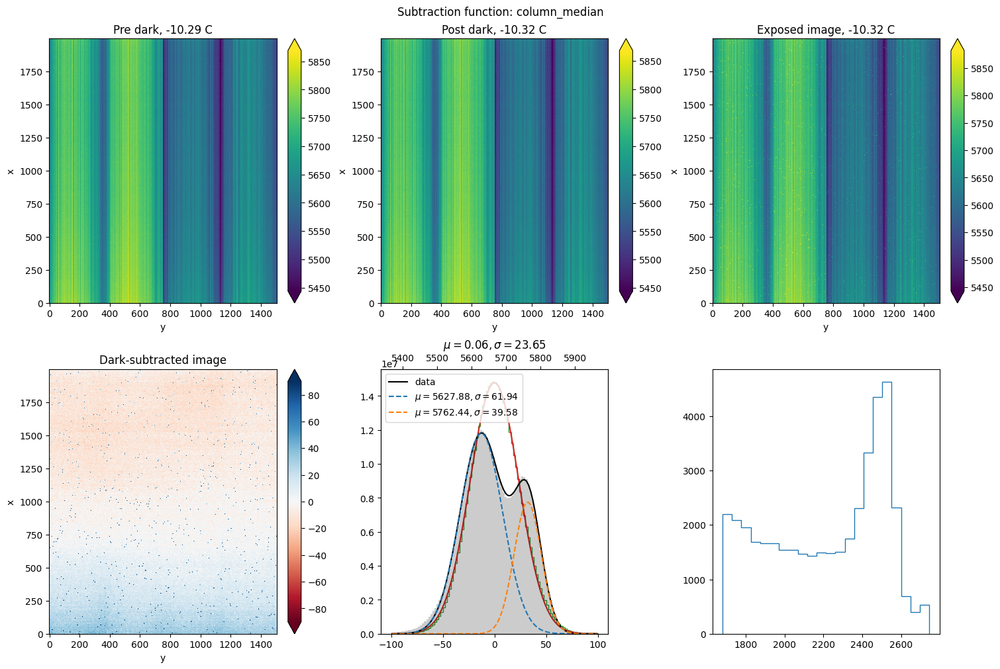

In [203]:
data_thresh = make_image_plots(ds_m10c, threshold_func=column_median)

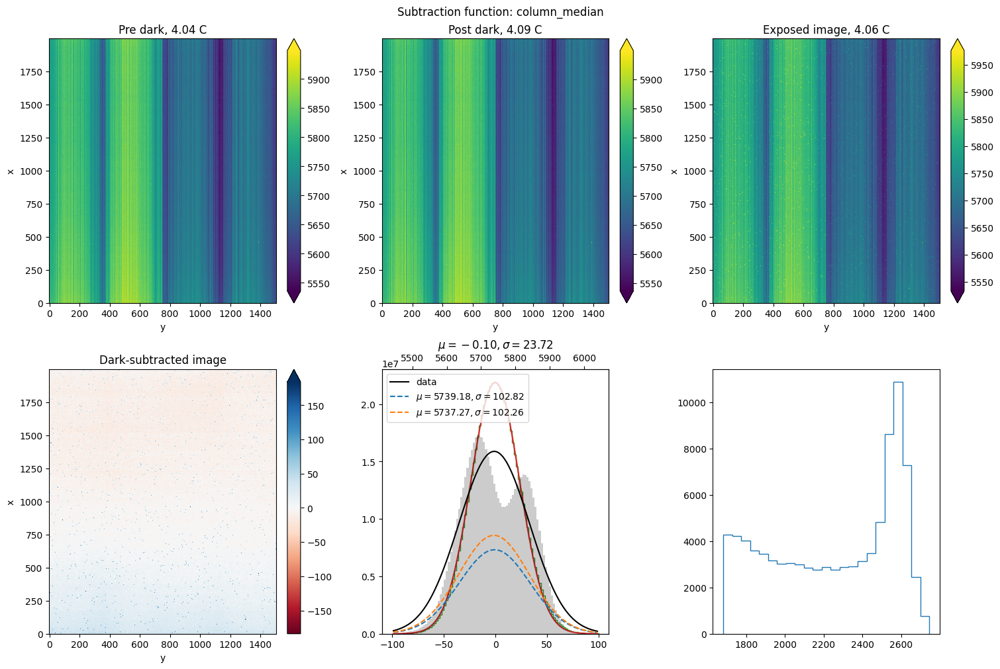

In [204]:
data_thresh = make_image_plots(ds_4c, threshold_func=column_median)

## Case 4: Mean along columns

In [205]:
def column_mean(pre, post, data):
    return data - xarray.concat([pre, post], 'sample').mean(dim=['sample','x'])

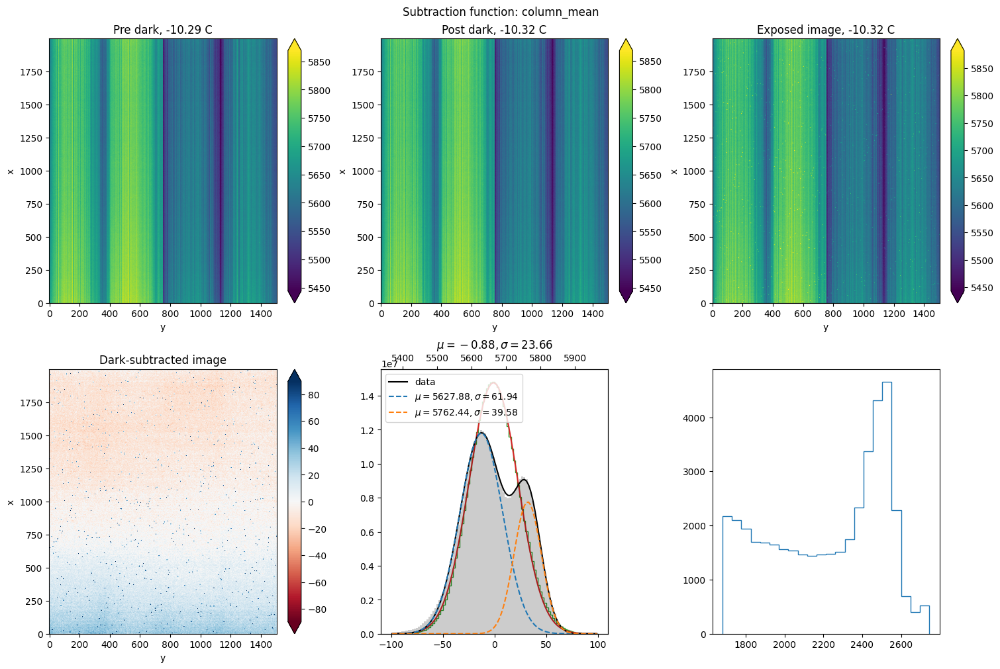

In [206]:
data_thresh_col_mean = make_image_plots(ds_m10c, threshold_func=column_mean)

## Case 5: Median along rows

In [207]:
def row_median(pre, post, data):
    return data - xarray.concat([pre, post], 'sample').median(dim=['sample','y'])

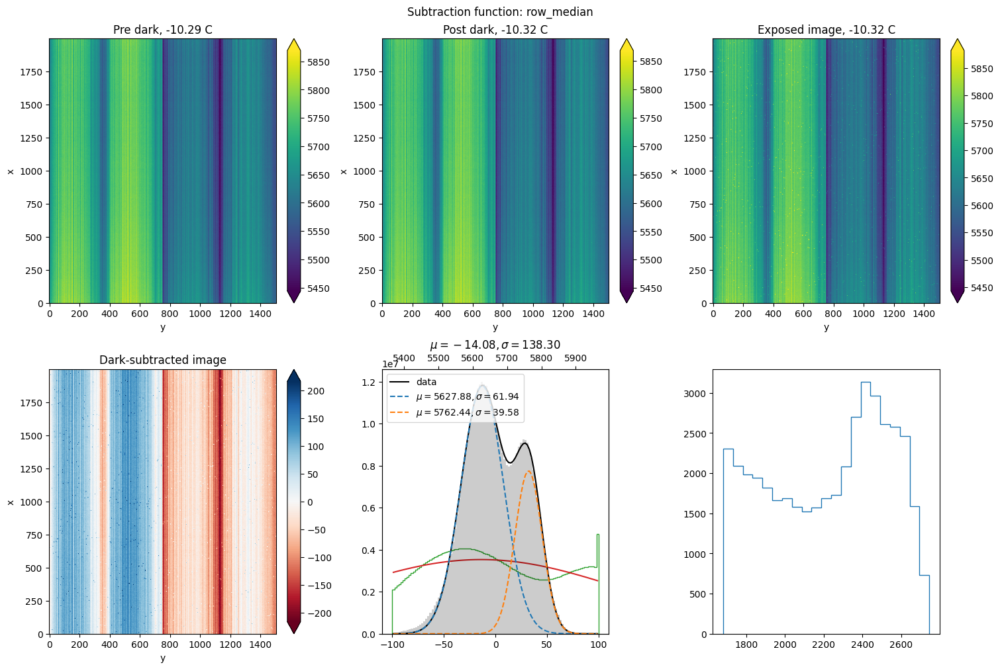

In [208]:
data_thresh = make_image_plots(ds_m10c, threshold_func=row_median)

## Case 6: Rolling median

In [256]:
def rolling_median(pre, post, data, sample=3):
    # The gymnastics of NaN filling are to ensure that the returned rolling median is the same size
    # as the data array. One could use interpolate_na to do this nearest neighbor extrapolation, but
    # it is very slow for arrays of this size. By applying fillna to either end with a sufficient size
    # to includ the NaNs as well as the first valid values, we avoid costly interpolation.
    rolling_median = data.rolling(sample=sample, center=True).median()
    rolling_median_nonan = rolling_median.dropna('sample')
    rolling_median[:sample,...] = rolling_median[:sample,...].fillna(rolling_median_nonan[0,...])
    rolling_median[-sample:,...] = rolling_median[-sample:,...].fillna(rolling_median_nonan[-1,...])
    return data - rolling_median

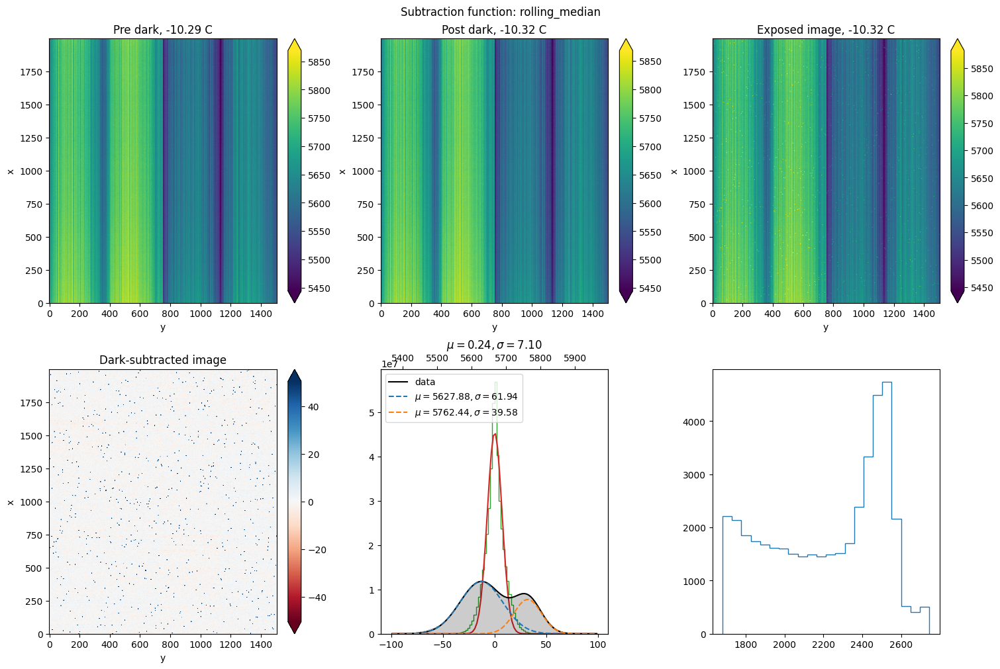

In [257]:
data_thresh_rolling = make_image_plots(ds_m10c, threshold_func=rolling_median, func_kwargs={'sample': 6})

## Case 7: Linear interpolation between top and bottom edge

- Buffer 10 frames
- for each column, do median of top 10 pixels (from top edge) across 10 frames
- same but from bottom edge
- linear interpolation from top and bottom

In [211]:
def buffer_interp_linear(pre, post, data, window_sample=10, window_x=10):
    mid_x = data.x.shape[0]//2
    i_max = data.sample.shape[0]
    threshold = []
    for i in range(i_max):
        i_start = max(0, i-window_sample/2)
        i_stop = min(i_max, i+window_sample/2)
        start_correction = i_start - (i-window_sample/2)
        stop_correction = i+window_sample/2 - i_stop
        i_start -= stop_correction
        i_stop += start_correction
        buffer = data[int(i_start):int(i_stop)]
        edges = xarray.concat(
            [
                buffer[:,:window_x,:].median(dim=['sample','x']),
                buffer[:,-window_x:,:].median(dim=['sample','x']),
            ],
            data.x[[window_x//2,-1-window_x//2]]
        )
        threshold.append(edges.interp(x=data.x, method='linear', kwargs={'fill_value': 'extrapolate'}))
    threshold = xarray.concat(threshold, data.sample)
    return data - threshold

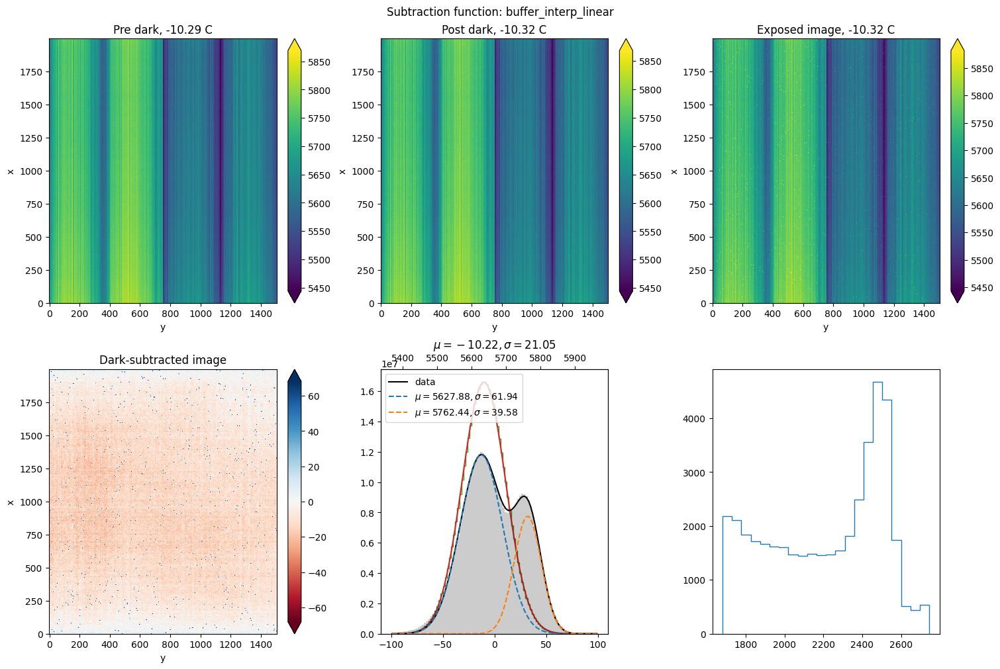

In [212]:
data_thresh_linear = make_image_plots(
    ds_m10c,
    threshold_func=buffer_interp_linear,
    data_index=10,
    func_kwargs={'window_x':100,'window_sample':1}
)

## Case 8: Quadratic interpolation between top and bottom edge

In [213]:
def buffer_interp_quadratic(pre, post, data, window_sample=10, window_x=10):
    mid_x = data.x.shape[0]//2
    i_max = data.sample.shape[0]
    threshold = []
    for i in range(i_max):
        i_start = max(0, i-window_sample/2)
        i_stop = min(i_max, i+window_sample/2)
        start_correction = i_start - (i-window_sample/2)
        stop_correction = i+window_sample/2 - i_stop
        i_start -= stop_correction
        i_stop += start_correction
        buffer = data[int(i_start):int(i_stop)]
        edges = xarray.concat(
            [
                buffer[:,:window_x,:].median(dim=['sample','x']),
                buffer[:,(mid_x-window_x//2):(mid_x+window_x//2),:].median(dim=['sample','x']),
                buffer[:,-window_x:,:].median(dim=['sample','x']),
            ],
            data.x[[window_x//2,mid_x,-1-window_x//2]]
        )
        threshold.append(edges.interp(x=data.x, method='quadratic', kwargs={'fill_value': 'extrapolate'}))
    threshold = xarray.concat(threshold, data.sample)
    return data - threshold

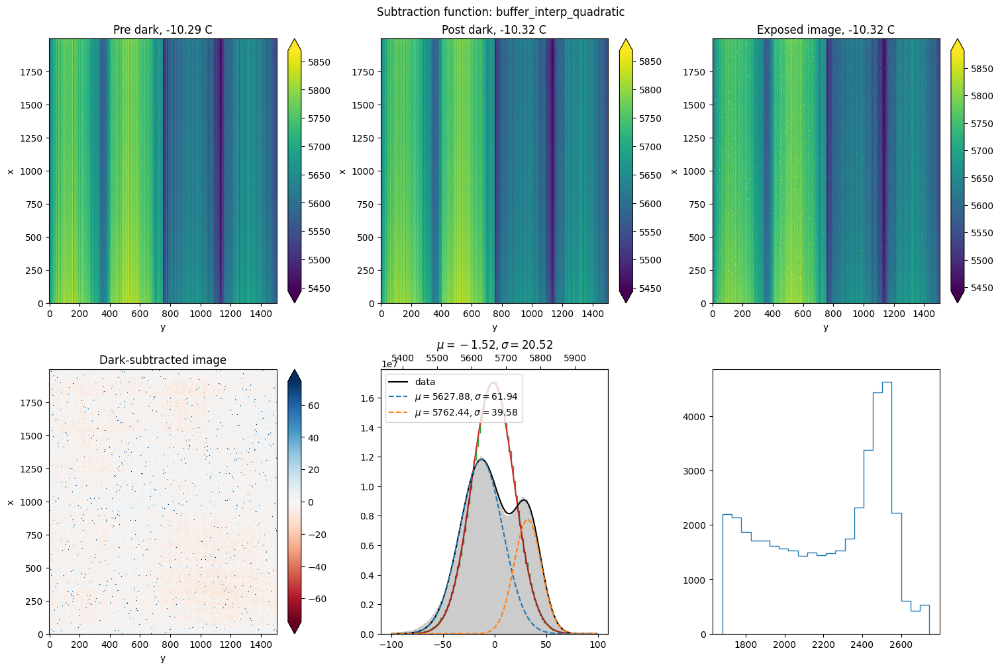

In [214]:
data_thresh_quad = make_image_plots(
    ds_m10c,
    threshold_func=buffer_interp_quadratic,
    data_index=10,
    func_kwargs={'window_x': 100, 'window_sample': 1}
)

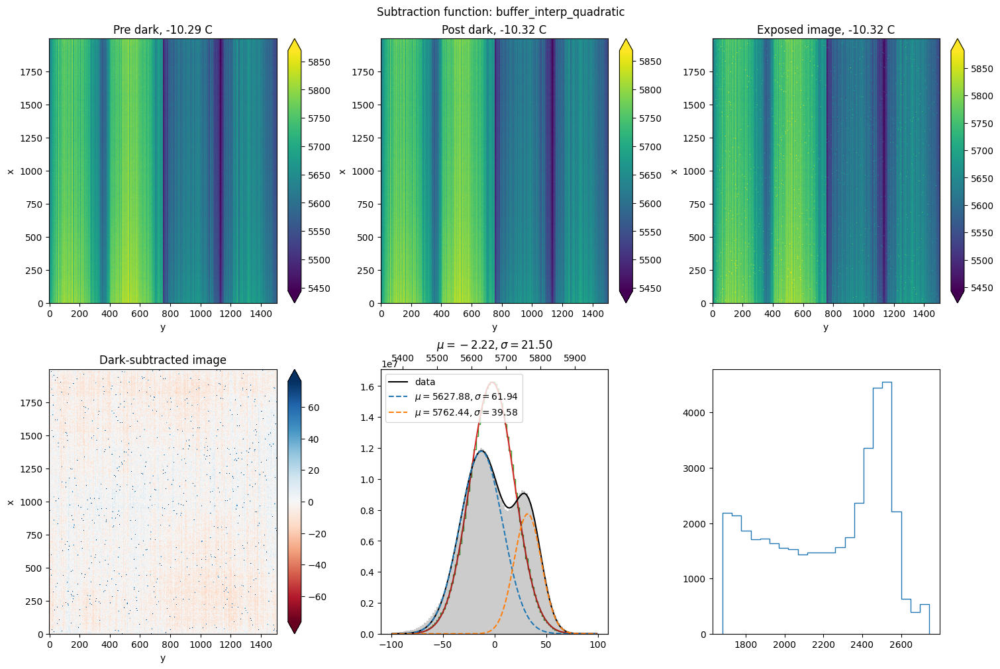

In [215]:
data_thresh = make_image_plots(
    ds_m10c,
    threshold_func=buffer_interp_quadratic,
    data_index=10,
    func_kwargs={'window_sample':1},
)

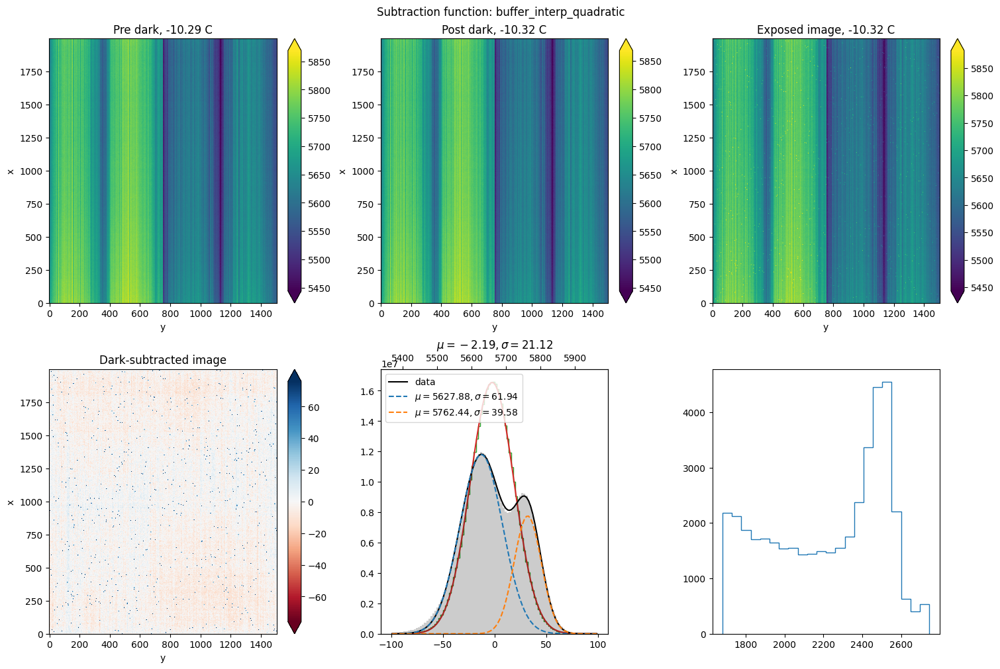

In [216]:
data_thresh = make_image_plots(ds_m10c, threshold_func=buffer_interp_quadratic, data_index=10, func_kwargs={'window_sample':20})

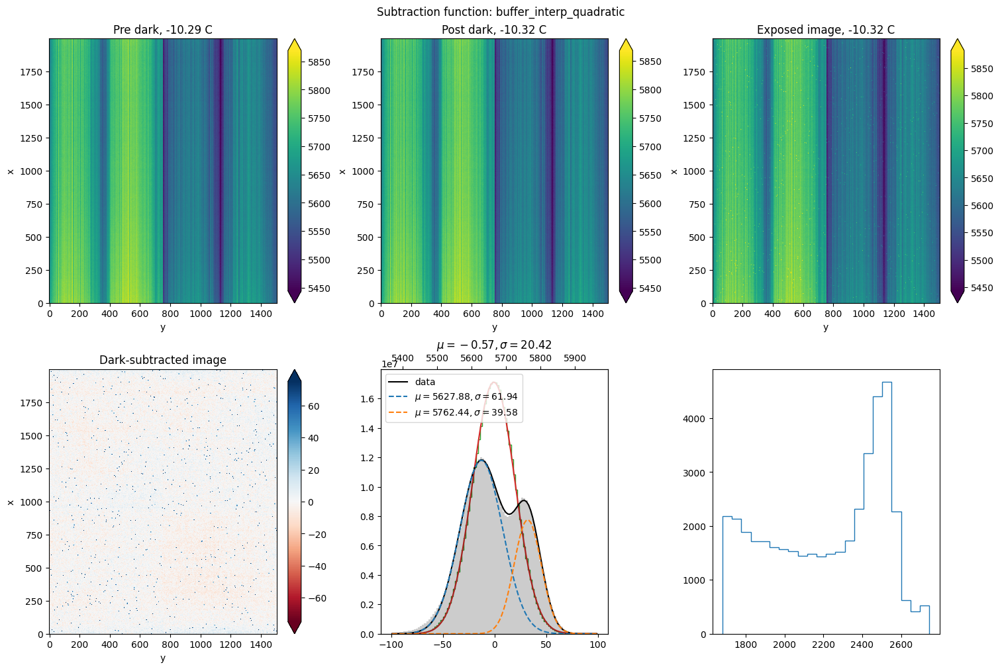

In [217]:
data_thresh = make_image_plots(
    ds_m10c,
    threshold_func=buffer_interp_quadratic,
    data_index=10,
    func_kwargs={'window_x':300,'window_sample':1}
)

## Case 9: Subtract cold darks from warm data

What happens if we apply bg subtraction with darks at a different temperature? Darks from coldest temperature applied to warmest temperature? 

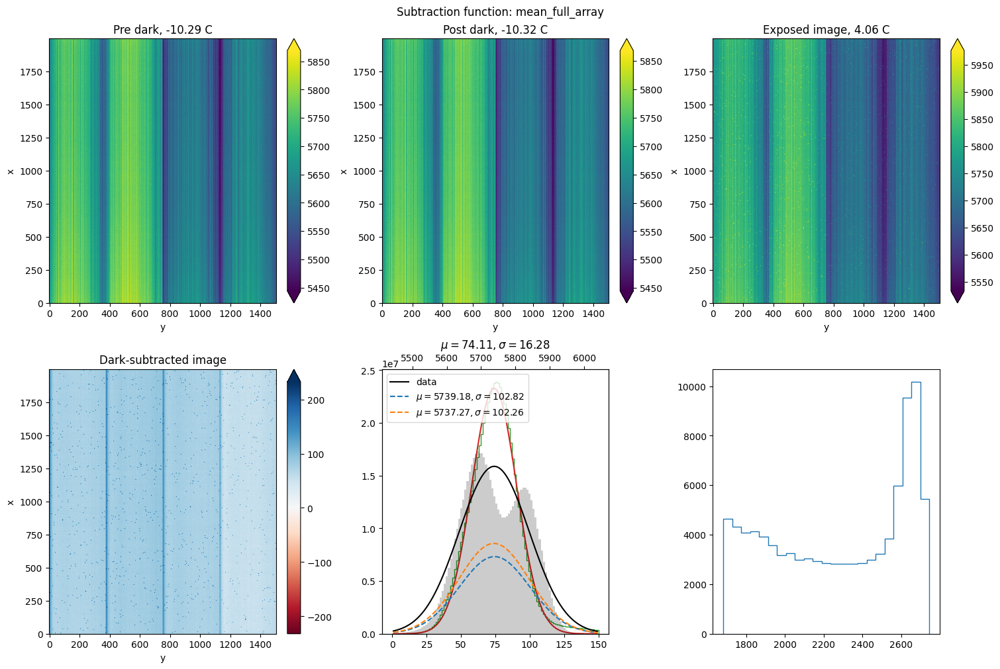

In [15]:
data_thresh_warm_cold = make_image_plots(
    {'pre_dark': ds_m10c['pre_dark'],
     'post_dark': ds_m10c['post_dark'],
     'data': ds_4c['data']},
    threshold_func=mean_full_array,
    hist_range=(0,150),
    mean_guess=75,
    stddev_guess=50,
)

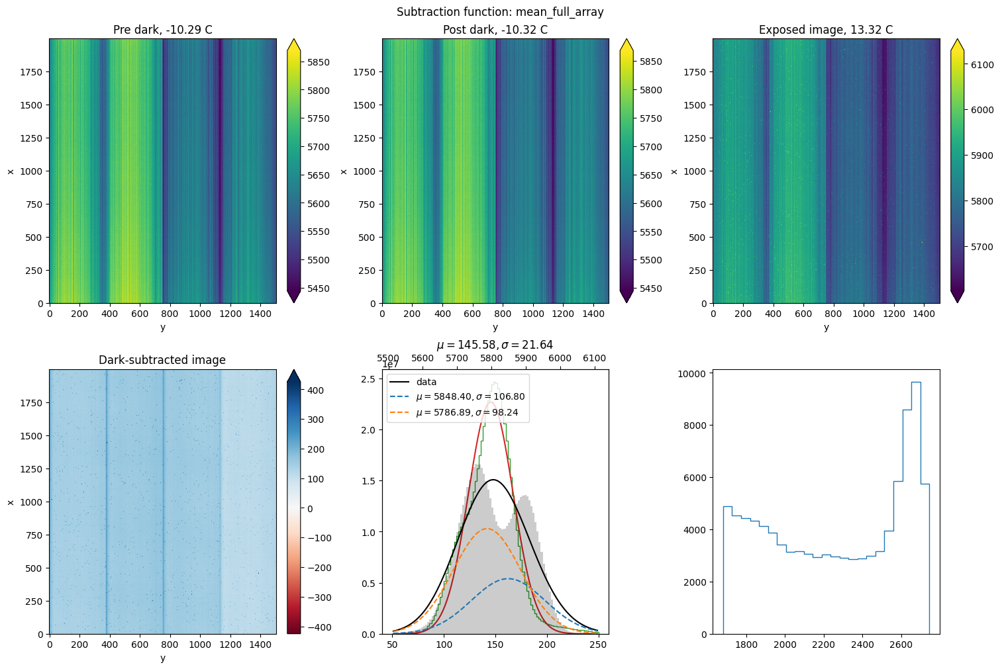

In [14]:
data_thresh_warm_cold = make_image_plots(
    {'pre_dark': ds_m10c['pre_dark'],
     'post_dark': ds_m10c['post_dark'],
     'data': ds_13c['data']},
    threshold_func=mean_full_array,
    hist_range=(50,250),
    mean_guess=75,
    stddev_guess=50,
)

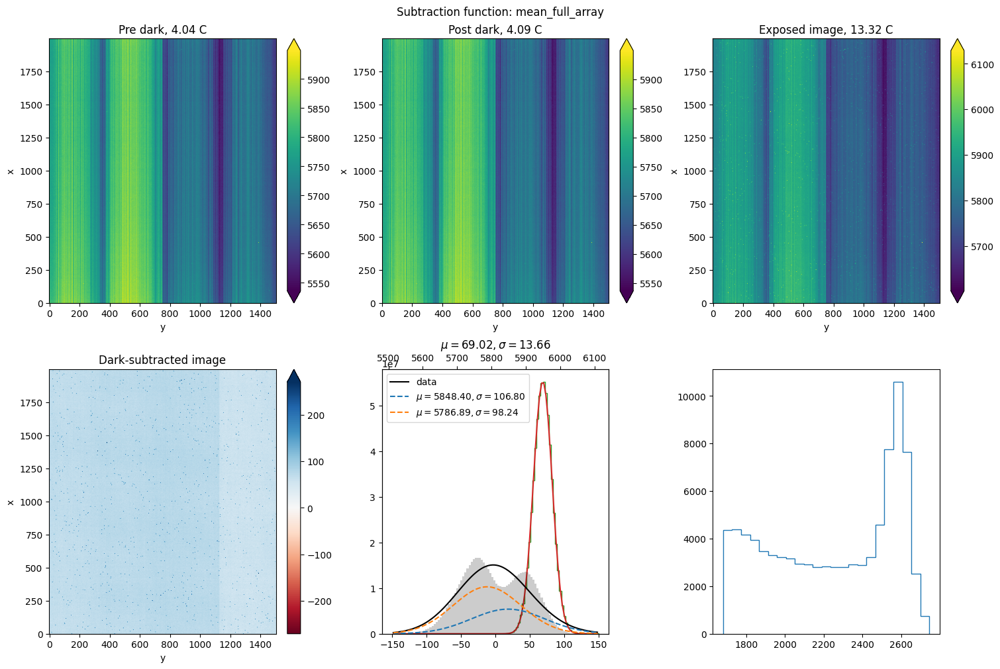

In [275]:
data_thresh_warm_cold = make_image_plots(
    {'pre_dark': ds_4c['pre_dark'],
     'post_dark': ds_4c['post_dark'],
     'data': ds_13c['data']},
    threshold_func=mean_full_array,
    hist_range=(-150,150),
    mean_guess=75,
    stddev_guess=50,
)

## Examining Different Sections of the Detector

In [35]:
domain_edges = [0,350,765,1140,1503]

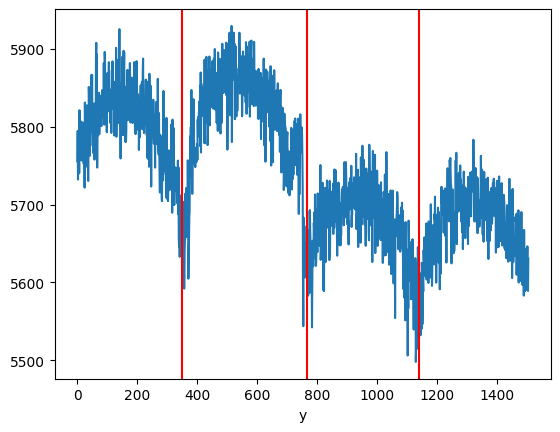

In [36]:
((ds_4c['pre_dark'].mean(dim=['sample','x'])+ds_4c['post_dark'].mean(dim=['sample','x']))/2).plot()
plt.axvline(x=350,color='r')
plt.axvline(x=765,color='r')
plt.axvline(x=1140,color='r')

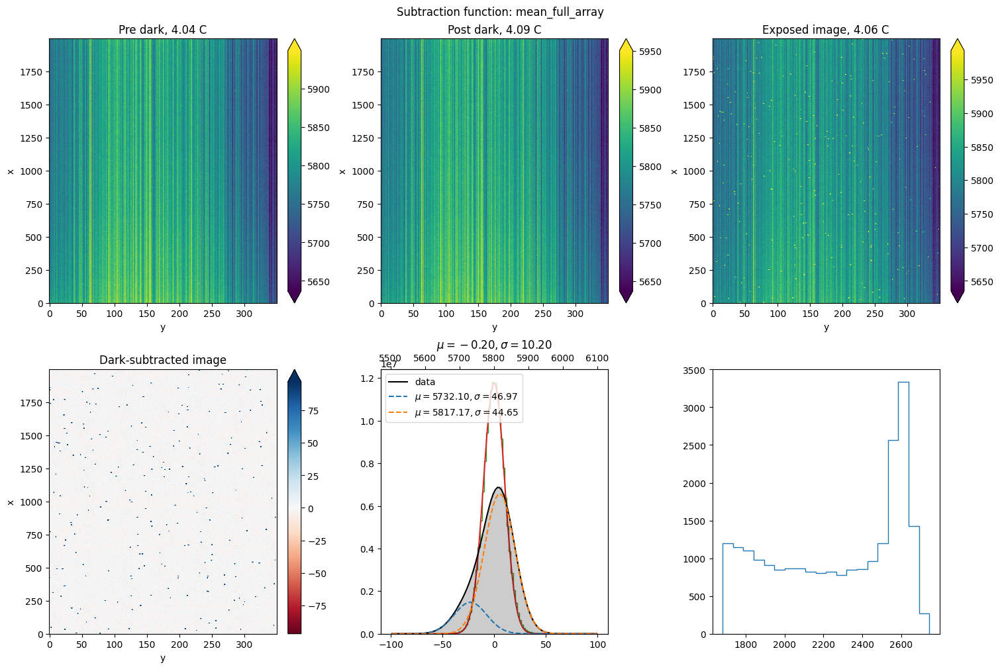

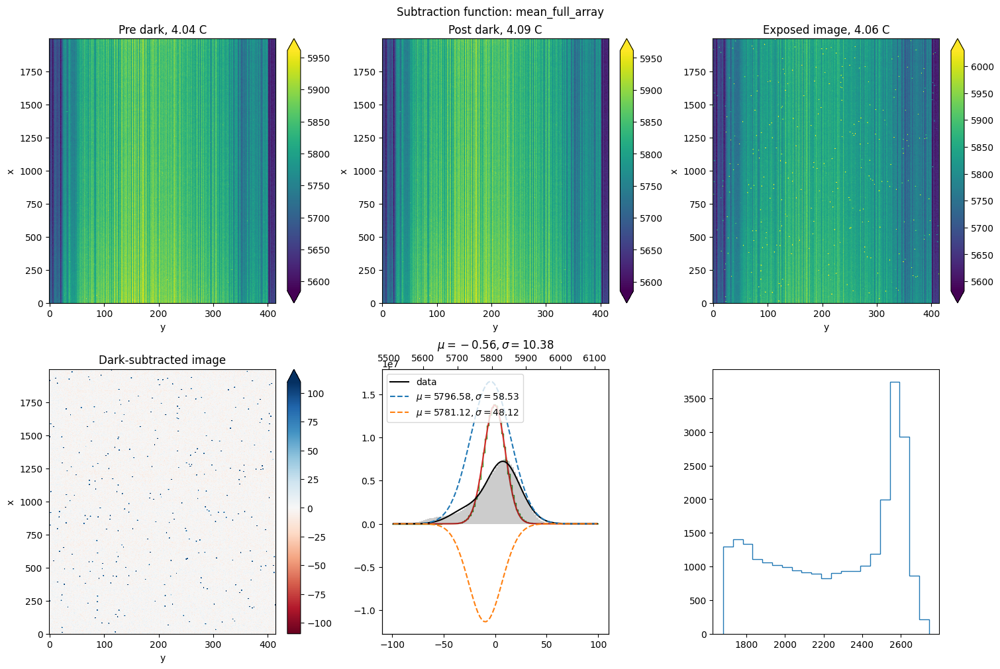

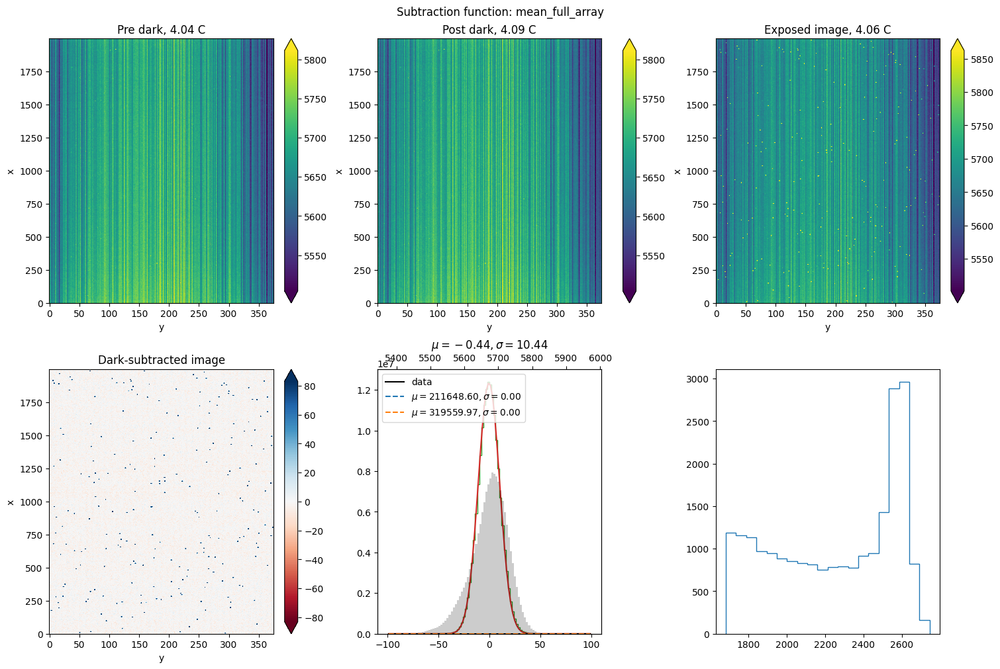

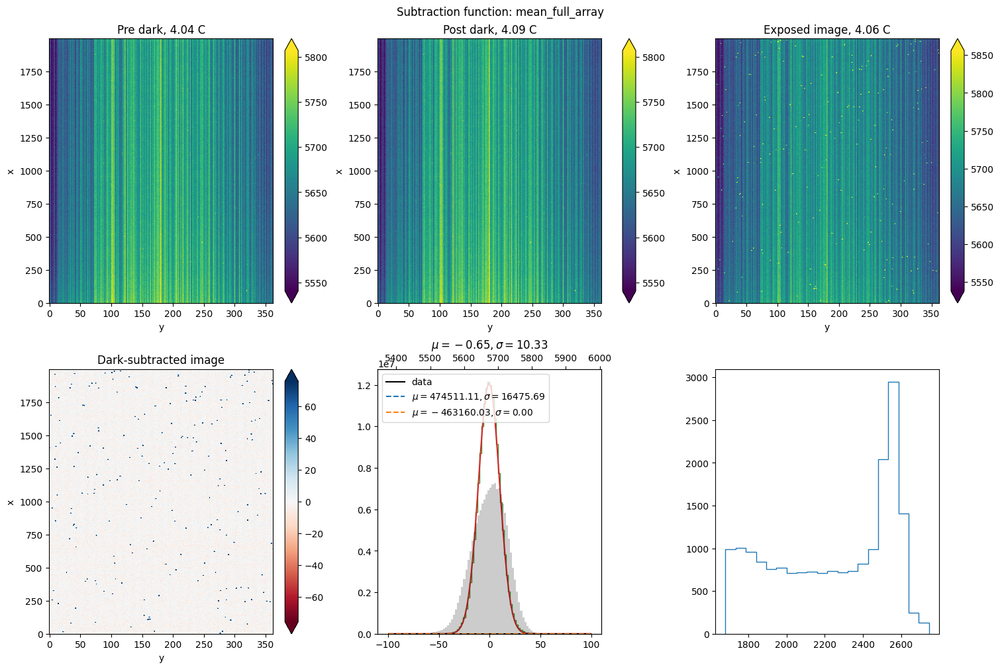

In [52]:
for i in range(len(domain_edges)-1):
    _ = make_image_plots(
        {'pre_dark': ds_4c['pre_dark'].sel(y=slice(domain_edges[i],domain_edges[i+1])),
         'post_dark': ds_4c['post_dark'].sel(y=slice(domain_edges[i],domain_edges[i+1])),
         'data': ds_4c['data'].sel(y=slice(domain_edges[i],domain_edges[i+1]))},
        threshold_func=mean_full_array,
        #hist_range=(-150,150),
        #mean_guess=75,
        #stddev_guess=50,
    )

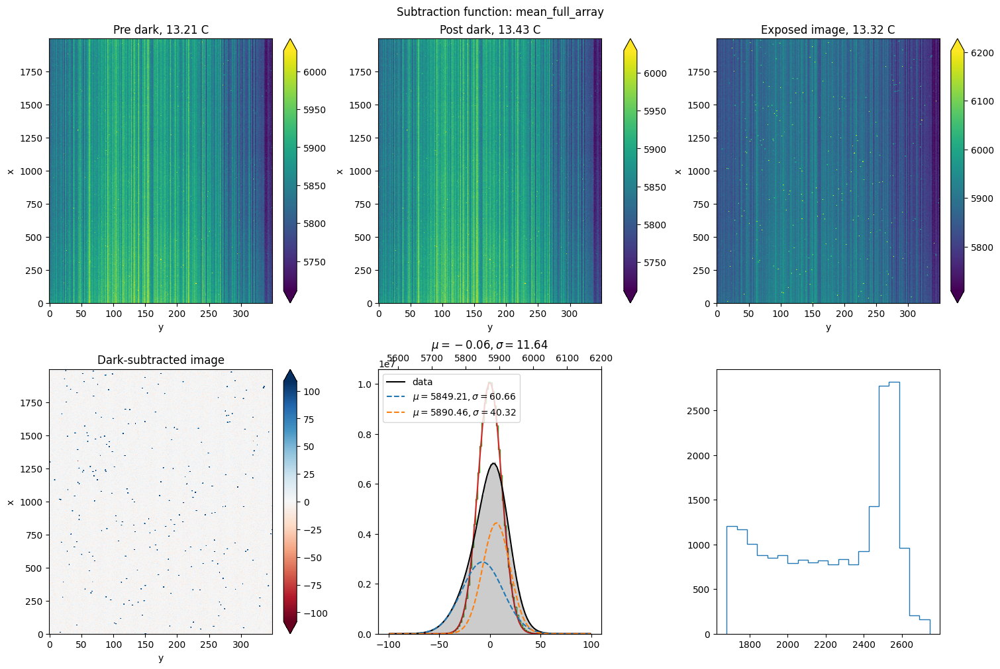

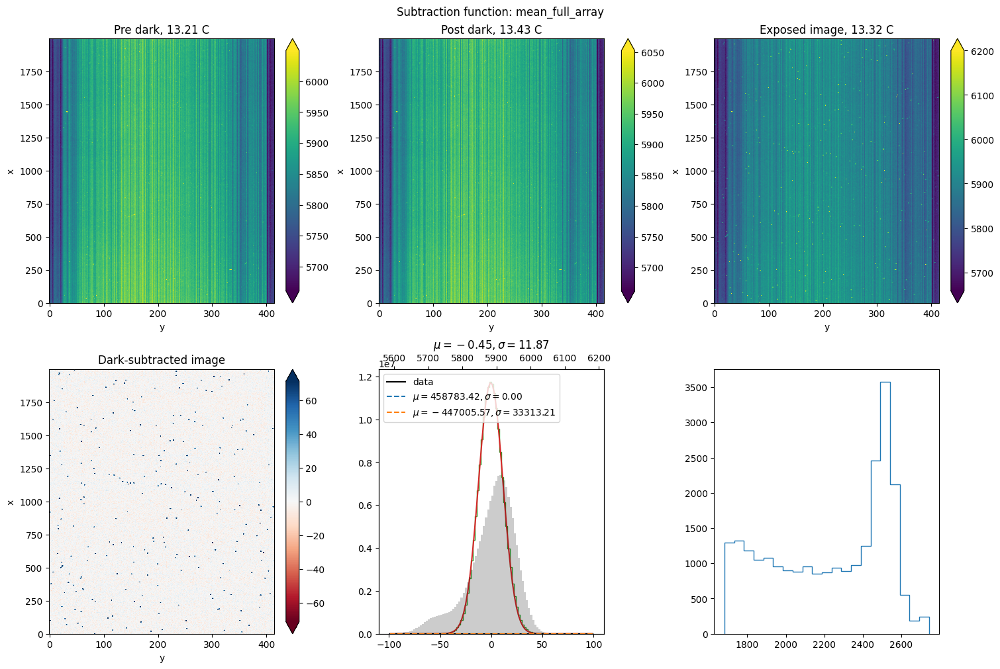

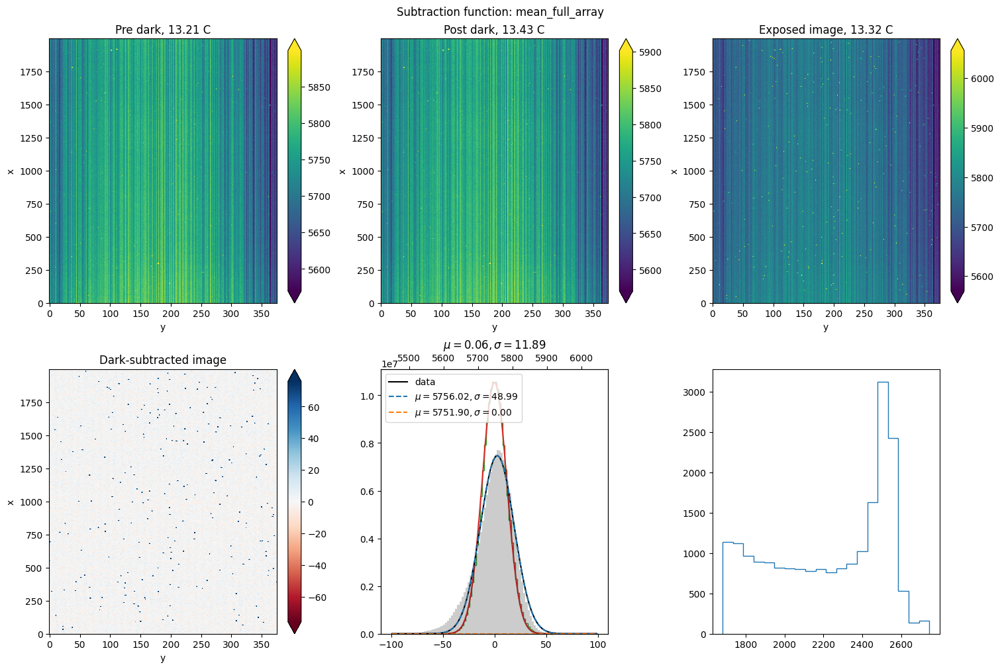

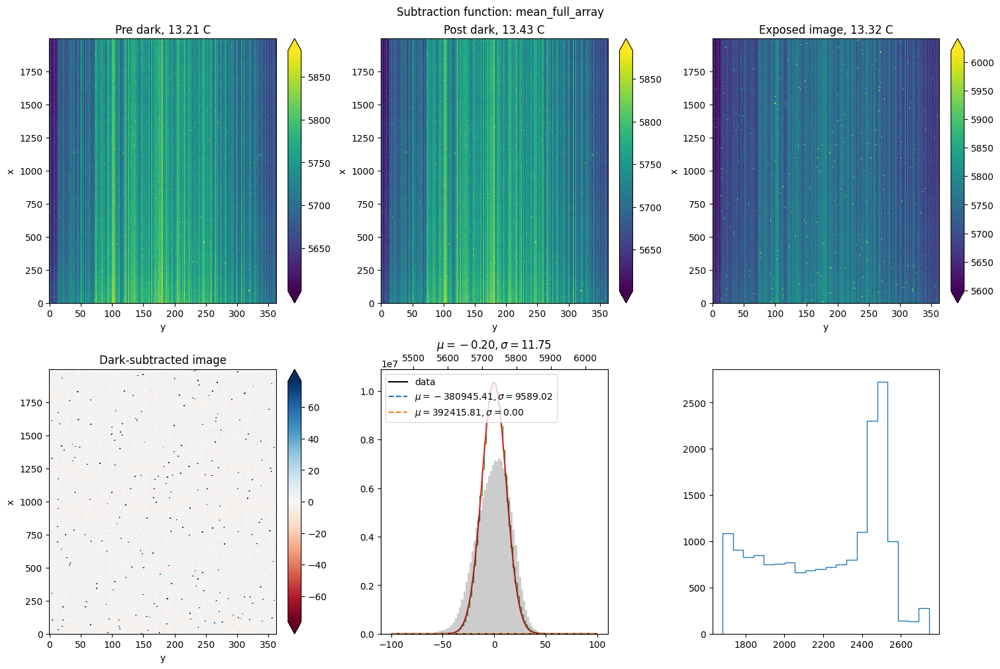

In [53]:
for i in range(len(domain_edges)-1):
    _ = make_image_plots(
        {'pre_dark': ds_13c['pre_dark'].sel(y=slice(domain_edges[i],domain_edges[i+1])),
         'post_dark': ds_13c['post_dark'].sel(y=slice(domain_edges[i],domain_edges[i+1])),
         'data': ds_13c['data'].sel(y=slice(domain_edges[i],domain_edges[i+1]))},
        threshold_func=mean_full_array,
        #hist_range=(-150,150),
        #mean_guess=75,
        #stddev_guess=50,
    )

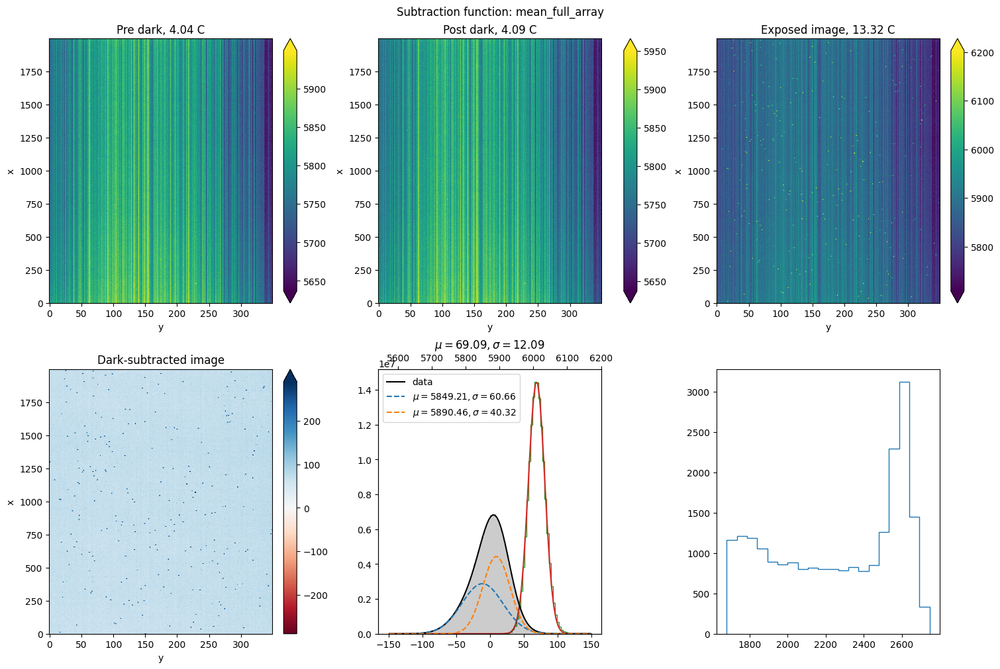

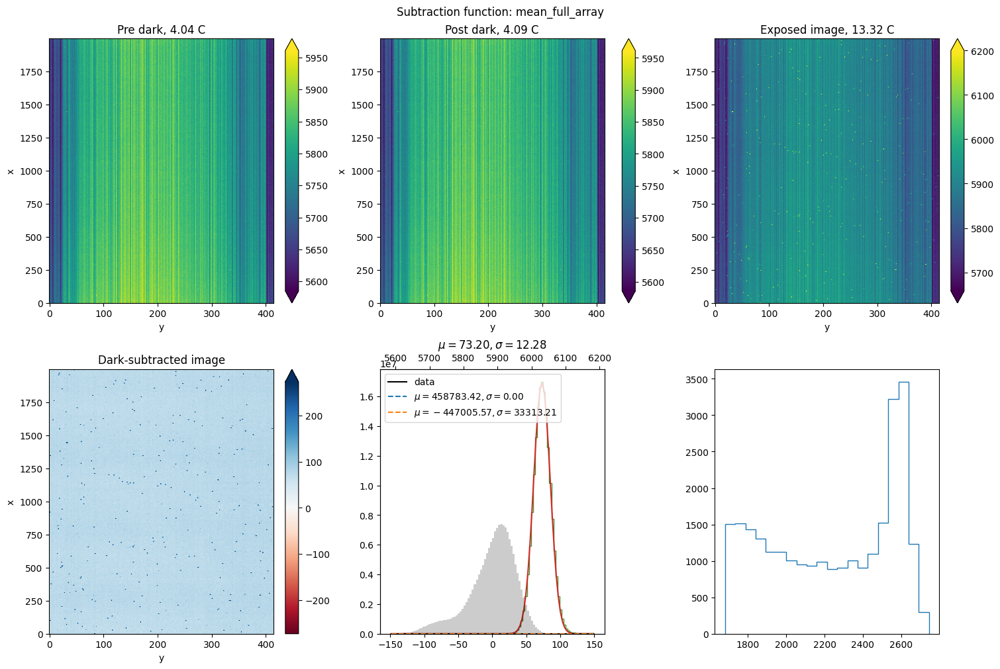

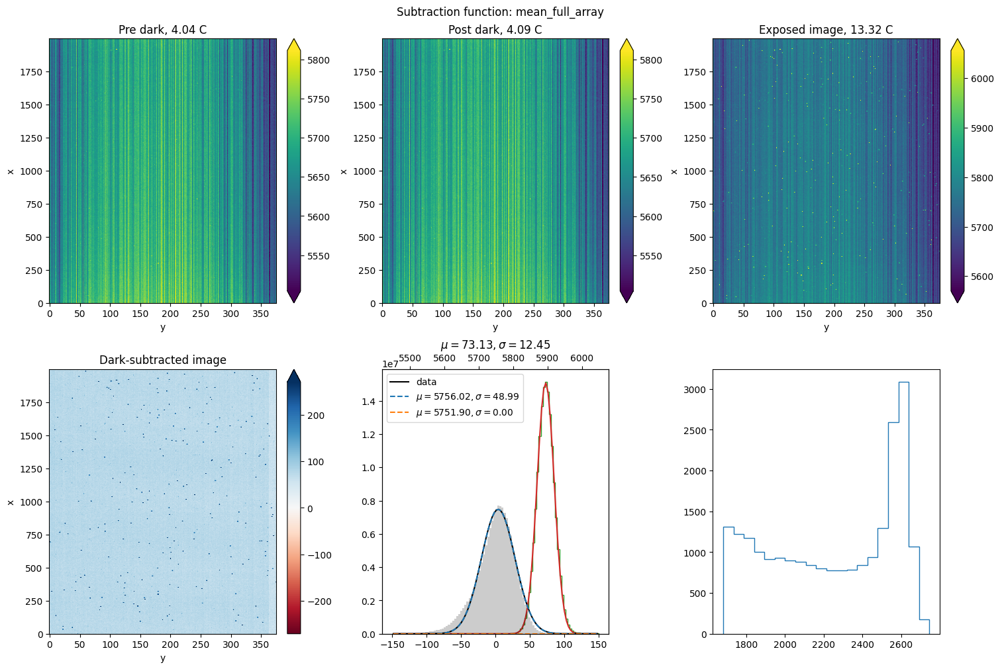

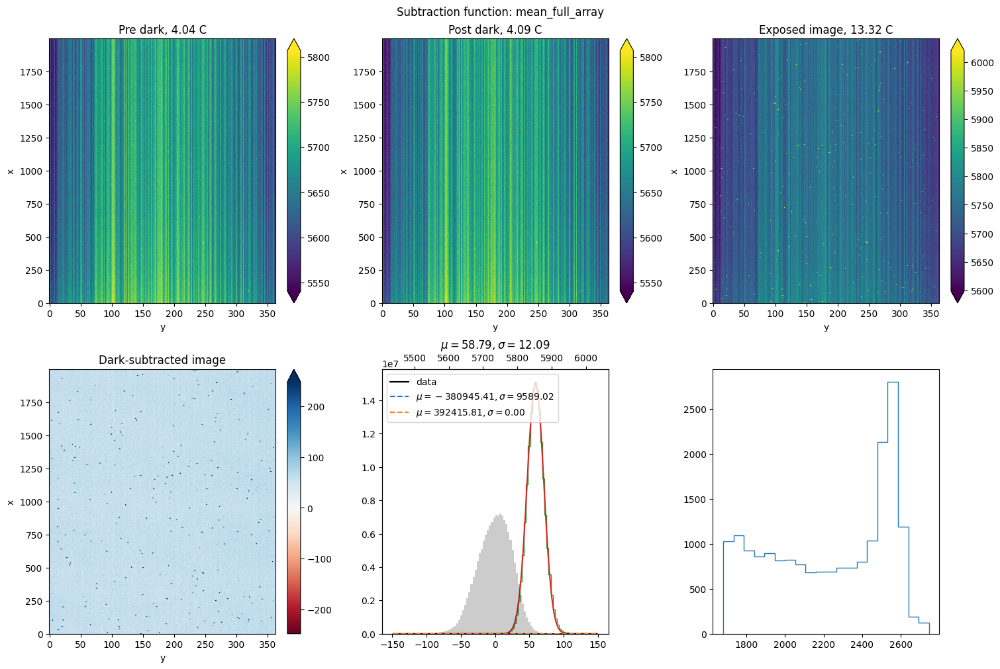

In [50]:
for i in range(len(domain_edges)-1):
    _ = make_image_plots(
        {'pre_dark': ds_4c['pre_dark'].sel(y=slice(domain_edges[i],domain_edges[i+1])),
         'post_dark': ds_4c['post_dark'].sel(y=slice(domain_edges[i],domain_edges[i+1])),
         'data': ds_13c['data'].sel(y=slice(domain_edges[i],domain_edges[i+1]))},
        threshold_func=mean_full_array,
        hist_range=(-150,150),
        mean_guess=75,
        stddev_guess=50,
    )

How much do these darks vary from one temperature to the next?

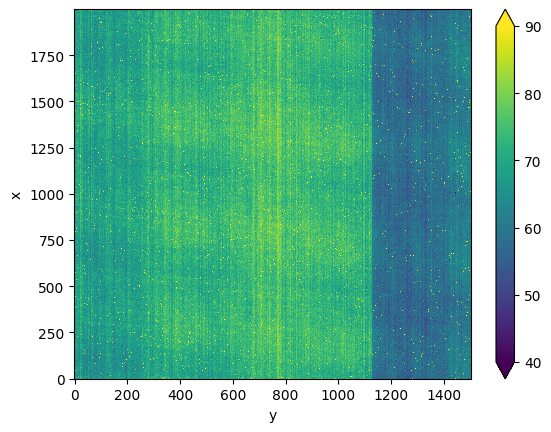

In [84]:
dark_average_4c = (ds_4c['pre_dark'].median(dim='sample')+ds_4c['post_dark'].median(dim='sample'))/2
dark_average_13c = (ds_13c['pre_dark'].median(dim='sample')+ds_13c['post_dark'].median(dim='sample'))/2
dark_difference = dark_average_13c - dark_average_4c
dark_difference.plot.imshow(interpolation='none', vmin=40,vmax=90,)

(50.0, 85.0)

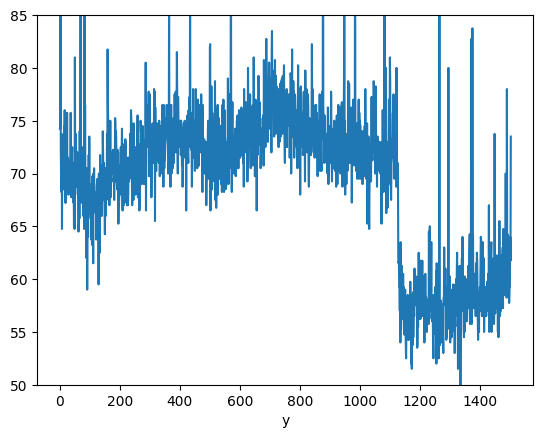

In [85]:
dark_difference.sel(x=1000).plot()
plt.ylim(50,85)

(65.0, 85.0)

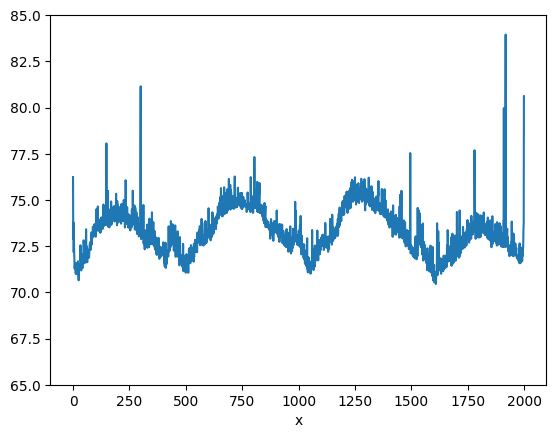

In [86]:
dark_difference.sel(y=slice(domain_edges[2],domain_edges[3])).mean(dim='y').plot()
plt.ylim(65,85)

## Case Comparison

Text(0, 0.5, 'Raw data')

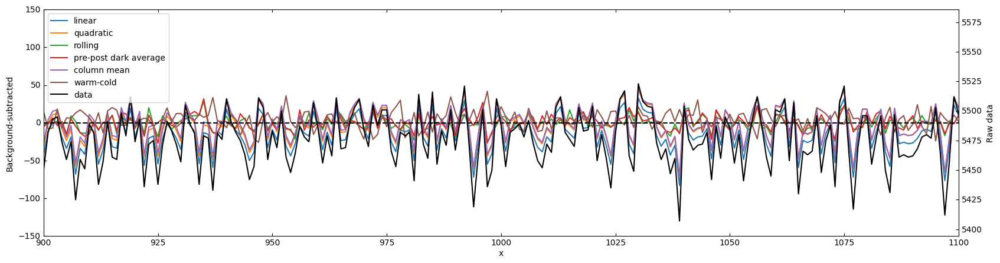

In [276]:
y_coord = 752
sample_coord = 73
fig = plt.figure(figsize=(20,5))
ax = host_subplot(111, figure=fig, axes_class=axisartist.Axes)
ax2 = ax.twinx()

data_thresh_linear.sel(sample=sample_coord, y=y_coord).plot(label='linear', alpha=1, ax=ax)
data_thresh_quad.sel(sample=sample_coord, y=y_coord).plot(label='quadratic', alpha=1, ax=ax)
data_thresh_rolling.sel(sample=sample_coord, y=y_coord).plot(label='rolling', alpha=1, ax=ax)
data_thresh_best.sel(sample=sample_coord, y=y_coord).plot(label='pre-post dark average', alpha=1, ax=ax)
data_thresh_col_mean.sel(sample=sample_coord, y=y_coord).plot(label='column mean', alpha=1, ax=ax)
(data_thresh_warm_cold.sel(sample=sample_coord, y=y_coord)-69.02).plot(label='warm-cold', alpha=1, ax=ax)
ds_m10c['data'].sel(sample=sample_coord, y=y_coord).plot(label='data', ax=ax2, color='k')
ax.axhline(y=0,ls='--',color='k')

ax.legend()
ax.set_ylim(-150,150)
#ax.set_xlim(0,2000)
ax.set_xlim(900,1100)
ax2.axis["right"].toggle(all=True)
ax.set_ylabel('Background-subtracted')
ax2.set_ylabel('Raw data')